<a href="https://colab.research.google.com/github/HILALOZTEMEL/chest-xray-preprocessing/blob/main/ChestX_ray8_ImageProcessing_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ChestX-ray8 Veri Setini Yüklemek

In [22]:
# Import necessary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import seaborn as sns
sns.set()

In [23]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 17.17 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


In [24]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


In [25]:
# Read csv file containing training datadata
train_df = pd.read_csv("nih/train-small.csv")
# Print first 5 rows
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head()

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


In [26]:
# Look at the data type of each column and whether null values are present
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

In [27]:
print(f"The total patient ids are {train_df['PatientId'].count()}, from those the unique ids are {train_df['PatientId'].value_counts().shape[0]} ")

The total patient ids are 1000, from those the unique ids are 928 


In [28]:
columns = train_df.keys()
columns = list(columns)
print(columns)

['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [29]:
# Remove unnecesary elements
columns.remove('Image')
columns.remove('PatientId')
# Get the total classes
print(f"There are {len(columns)} columns of labels for these conditions: {columns}")

There are 14 columns of labels for these conditions: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [30]:
# Print out the number of positive labels for each class
for column in columns:
    print(f"The class {column} has {train_df[column].sum()} samples")

The class Atelectasis has 106 samples
The class Cardiomegaly has 20 samples
The class Consolidation has 33 samples
The class Edema has 16 samples
The class Effusion has 128 samples
The class Emphysema has 13 samples
The class Fibrosis has 14 samples
The class Hernia has 2 samples
The class Infiltration has 175 samples
The class Mass has 45 samples
The class Nodule has 54 samples
The class Pleural_Thickening has 21 samples
The class Pneumonia has 10 samples
The class Pneumothorax has 38 samples


# Verilerin Görselleştirmesi
- Ramdom 9 tane veri seçilir.

Display Random Images


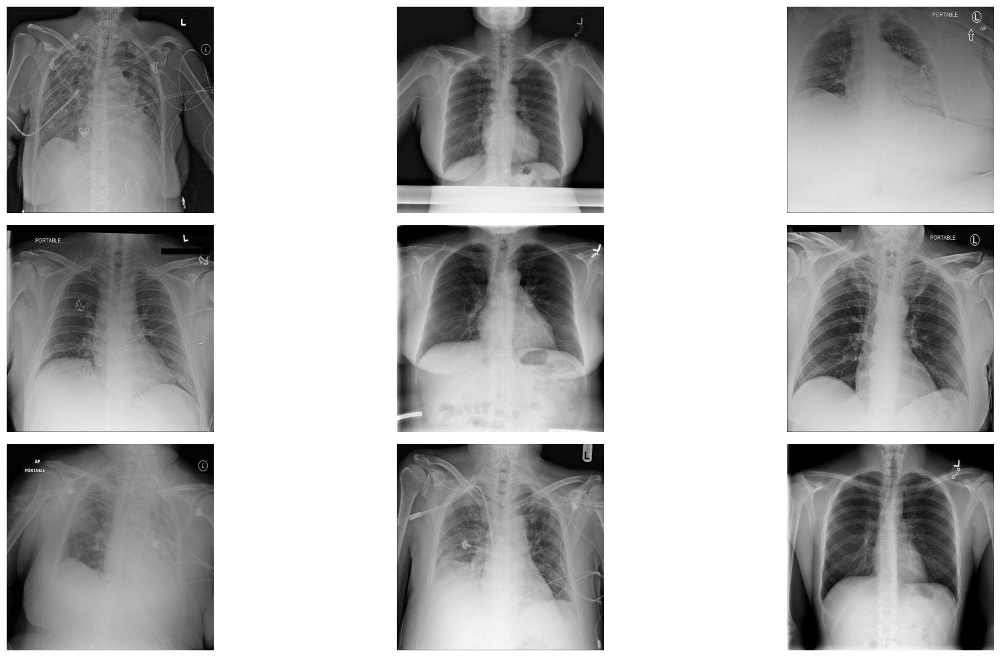

In [31]:
# Extract numpy values from Image column in data frame
images = train_df['Image'].values

# Extract 9 random images from it
random_images = [np.random.choice(images) for i in range(9)]

# Location of the image dir
img_dir = 'nih/images_small/'

print('Display Random Images')

# Adjust the size of your images
plt.figure(figsize=(20,10))

# Iterate and plot random images
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

# Adjust subplot parameters to give specified padding
plt.tight_layout()

# Görüntü İşleme ve İyileştirme (Pre-processing)

- **Görüntüyü Yükleme:** Gri tonlamalı olarak yüklenir.
- **Kırpma İşlemi:** Kenarlardan belirlenen miktarda keserek akciğer bölgesi korunur.
- **Sonuçların Görselleştirilmesi:** Orijinal ve kırpılmış görüntüler yan yana gösterilir.

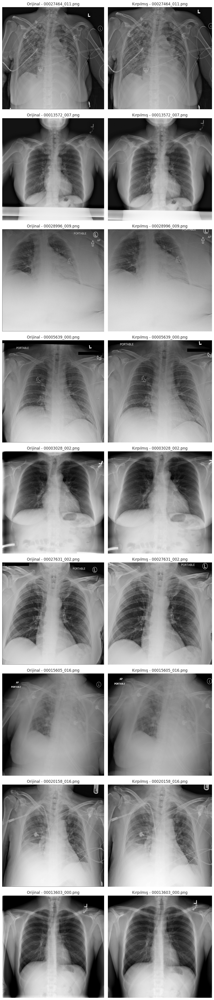

In [32]:
import cv2
# Kırpma miktarları (Bu değerleri ihtiyaca göre ayarlayabilirsiniz)
crop_x_start, crop_x_end = 30, -30  # Sol ve sağ kenardan kırp
crop_y_start, crop_y_end = 40, -40  # Üst ve alt kenardan kırp

# Sonuçları saklamak için liste
results = []

# Görselleştirme için figür oluştur
fig, axes = plt.subplots(9, 2, figsize=(10, 45))

# Her bir rastgele görüntü için işlemleri uygula
for i, img_name in enumerate(random_images):
    # Görüntüyü yükle (Gri tonlamalı olarak)
    img_path = os.path.join(img_dir, img_name)
    image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

    # Orijinal boyutları kaydet
    original_shape = image.shape

    # Kenarlardan kırpma işlemi
    cropped_image = image[crop_y_start:crop_y_end, crop_x_start:crop_x_end]

    # Kırpılmış boyutları kaydet
    cropped_shape = cropped_image.shape

    # Sonuçları tabloya ekle
    results.append([img_name, original_shape, cropped_shape])

    # Görüntüleri görselleştir
    axes[i, 0].imshow(image, cmap='gray')
    axes[i, 0].set_title(f"Orijinal - {img_name}")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(cropped_image, cmap='gray')
    axes[i, 1].set_title(f"Kırpılmış - {img_name}")
    axes[i, 1].axis("off")

# Grafikleri göster
plt.tight_layout()
plt.show()

## Kontrast Germe (Stretching) Histogram Eşitleme (Equalization) yöntemleri
### Kontrast Germe (Stretching):

Görüntünün kontrastını artırarak daha fazla detayın görünmesini sağlar.
Düşük kontrastlı bir görüntüyü iyileştirir ve analizi kolaylaştırır.
Özellikle karanlık veya aşırı aydınlatılmış bölgelerde önemli detayların öne çıkmasını sağlar.
### Histogram Eşitleme (Equalization):

Görüntünün parlaklık dağılımını iyileştirir.
Renk tonlarının homojen bir şekilde dağılmasını sağlar ve görsel kaliteyi artırır.
Örneğin, düşük ışıklı bir görüntünün detaylarını daha belirgin hale getirir.

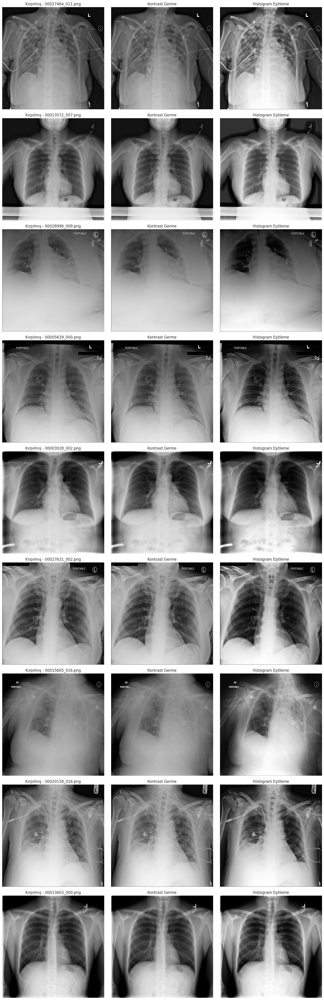

In [33]:
# 3 sütunlu bir subplot oluştur
fig, axes = plt.subplots(9, 3, figsize=(15, 45))  # 9 satır, 3 sütun4

# Sonuçları saklamak için liste
results_2 = []

for i, (img_name, _, cropped_shape) in enumerate(results):  # Kırpılmış görüntülerle devam ediyoruz
    # Görüntüyü yükle (Gri tonlamalı olarak)
    img_path = os.path.join(img_dir, img_name)
    cropped_image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)  # Gri tonlama

    # 1. Kontrast Germe (Stretching)
    stretched_image = cv2.normalize(cropped_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)

    # 2. Histogram Eşitleme (Equalization)
    equalized_image = cv2.equalizeHist(cropped_image)

    # Görüntüleri görselleştir
    axes[i, 0].imshow(cropped_image, cmap='gray')
    axes[i, 0].set_title(f"Kırpılmış - {img_name}")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(stretched_image, cmap='gray')
    axes[i, 1].set_title("Kontrast Germe")
    axes[i, 1].axis("off")

    axes[i, 2].imshow(equalized_image, cmap='gray')
    axes[i, 2].set_title("Histogram Eşitleme")
    axes[i, 2].axis("off")

    # Sonuçları güncelle
    results_2.append([img_name, cropped_shape, stretched_image, equalized_image])

# Görselleri göster
plt.tight_layout()
plt.show()


## Gaussian Blur

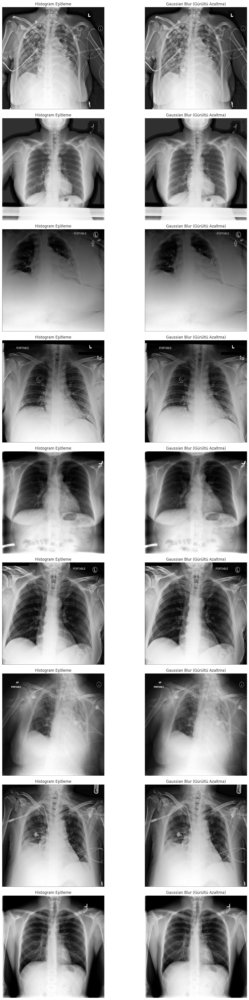

In [34]:
import matplotlib.pyplot as plt
import cv2

# 9 satır, 2 sütun için subplot oluştur
fig, axes = plt.subplots(9, 2, figsize=(15, 45))  # Her bir görüntü için 2 sütun: Histogram Eşitleme ve Gaussian Blur

results_3 = []
for i, (img_name, cropped_shape, stretched_image, equalized_image) in enumerate(results_2):
    # Histogram Eşitleme Görselleştirme
    axes[i, 0].imshow(equalized_image, cmap='gray')
    axes[i, 0].set_title("Histogram Eşitleme")
    axes[i, 0].axis("off")

    # Gaussian Blur (Gauss Filtresi)
    gaussian_blurred = cv2.GaussianBlur(equalized_image, (3, 3), 0)  # Kernel size = (3,3)
    axes[i, 1].imshow(gaussian_blurred, cmap='gray')
    axes[i, 1].set_title("Gaussian Blur (Gürültü Azaltma)")
    axes[i, 1].axis("off")

    # Sonuçları kaydet
    results_3.append([img_name, gaussian_blurred])

# Boş grafik hatalarını önlemek için eksik eksenleri gizleyin
for j in range(len(results_2), 9):
    for k in range(2):  # Sadece 2 sütun olduğu için
        axes[j, k].axis("off")  # Fazla eksenleri kapat

# Görselleri hizala ve göster
plt.tight_layout()
plt.show()


# Eşik sayısı belirleme

00027464_011.png: Ortalama = 128.01, Standart Sapma = 73.30
Eşik Değerleri: [-18.590984408065253, 54.711165396370205, 128.01331520080566, 201.31546500524112, 274.6176148096766]
00013572_007.png: Ortalama = 128.43, Standart Sapma = 72.51
Eşik Değerleri: [-16.579750494086085, 55.92542769714031, 128.4306058883667, 200.93578407959308, 273.44096227081945]
00028996_009.png: Ortalama = 128.08, Standart Sapma = 73.52
Eşik Değerleri: [-18.966484795909224, 54.55651008541331, 128.07950496673584, 201.60249984805836, 275.1254947293809]
00005639_000.png: Ortalama = 122.24, Standart Sapma = 76.47
Eşik Değerleri: [-30.698455640291485, 45.769252862227304, 122.2369613647461, 198.7046698672649, 275.1723783697837]
00003028_002.png: Ortalama = 124.87, Standart Sapma = 75.53
Eşik Değerleri: [-26.181375661013277, 49.34572402709834, 124.87282371520996, 200.39992340332157, 275.92702309143317]
00027631_002.png: Ortalama = 127.22, Standart Sapma = 74.06
Eşik Değerleri: [-20.895297863204178, 53.160254548927696, 1

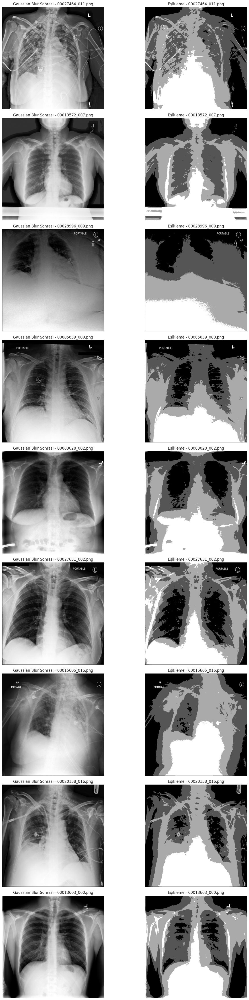

In [35]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# 9 satır, 2 sütun için subplot oluştur
fig, axes = plt.subplots(9, 2, figsize=(15, 45))
results_4 = []

for i, (img_name, gaussian_blurred) in enumerate(results_3):  # Sonuç listesindeki her bir görüntü için işlem yap

    # Ortalama ve standart sapma hesapla
    mean_intensity = np.mean(gaussian_blurred)
    std_intensity = np.std(gaussian_blurred)

    # 5 eşik ve 6 bölge için eşik değerlerini belirle
    thresholds = [
        mean_intensity - 2 * std_intensity,
        mean_intensity - std_intensity,
        mean_intensity,
        mean_intensity + std_intensity,
        mean_intensity + 2 * std_intensity,
    ]

    print(f"{img_name}: Ortalama = {mean_intensity:.2f}, Standart Sapma = {std_intensity:.2f}")
    print(f"Eşik Değerleri: {thresholds}")

    # Dinamik eşikleme ve bölge belirleme
    thresholded_image = np.zeros_like(gaussian_blurred)  # Eşiklenmiş görüntü
    thresholded_image[gaussian_blurred < thresholds[0]] = 0    # Bölge 1 (En alt yoğunluk)
    thresholded_image[(gaussian_blurred >= thresholds[0]) & (gaussian_blurred < thresholds[1])] = 51   # Bölge 2
    thresholded_image[(gaussian_blurred >= thresholds[1]) & (gaussian_blurred < thresholds[2])] = 102  # Bölge 3
    thresholded_image[(gaussian_blurred >= thresholds[2]) & (gaussian_blurred < thresholds[3])] = 153  # Bölge 4
    thresholded_image[(gaussian_blurred >= thresholds[3]) & (gaussian_blurred < thresholds[4])] = 204  # Bölge 5
    thresholded_image[gaussian_blurred >= thresholds[4]] = 255  # Bölge 6 (En üst yoğunluk)

    # Görselleştirme
    axes[i, 0].imshow(gaussian_blurred, cmap='gray')
    axes[i, 0].set_title(f"Gaussian Blur Sonrası - {img_name}")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(thresholded_image, cmap='gray')
    axes[i, 1].set_title(f"Eşikleme - {img_name}")
    axes[i, 1].axis("off")

    results_4.append([img_name, gaussian_blurred,thresholded_image])

plt.tight_layout()
plt.show()


# Genel Değerlendirme:
- Görüntülerin çoğu, ortalama parlaklık değerine göre orta seviyede (120-130 aralığında) parlaklık sergilemektedir. Bu, genel olarak dengeli aydınlatma şartlarına işaret eder.
- Görüntülerdeki standart sapma değerleri (~70-80 aralığı), tüm görüntülerde geniş bir parlaklık çeşitliliği olduğunu gösterir. Bu, özellikle kontrast artırma veya histogram eşitleme gibi iyileştirme işlemlerinin etkili olabileceğini düşündürür.
- Görüntülerin parlaklık seviyeleri arasında ciddi bir anormallik gözlemlenmemiştir, ancak bazı görüntüler (örn. 00017714_028.png) nispeten daha koyu bir yapıya sahiptir ve iyileştirme gerektirebilir.

# Thresholding



**Otsu Thresholding:** Daha net nesne-arka plan ayrımı gereken durumlarda kullanışlıdır. Özellikle arka planın gürültüsüz olduğu ve global bir eşik değeri yeterli olduğu durumlarda tercih edilir.

**Li Thresholding:** Daha karmaşık yapılar veya düşük kontrastlı nesneler içeren görüntüler için uygundur. Daha detaylı segmentasyon yapar ancak daha fazla gürültüye sebep olabilir.

00027464_011.png için:
  - Otsu Eşiği: 127.00
  - Li Eşiği: 103.01
  - Li Thresholding, Otsu'ya göre daha düşük bir eşik değeri sağladı.
00013572_007.png için:
  - Otsu Eşiği: 129.00
  - Li Eşiği: 106.22
  - Li Thresholding, Otsu'ya göre daha düşük bir eşik değeri sağladı.
00028996_009.png için:
  - Otsu Eşiği: 128.00
  - Li Eşiği: 103.10
  - Li Thresholding, Otsu'ya göre daha düşük bir eşik değeri sağladı.
00005639_000.png için:
  - Otsu Eşiği: 122.00
  - Li Eşiği: 92.24
  - Li Thresholding, Otsu'ya göre daha düşük bir eşik değeri sağladı.
00003028_002.png için:
  - Otsu Eşiği: 124.00
  - Li Eşiği: 96.36
  - Li Thresholding, Otsu'ya göre daha düşük bir eşik değeri sağladı.
00027631_002.png için:
  - Otsu Eşiği: 126.00
  - Li Eşiği: 101.17
  - Li Thresholding, Otsu'ya göre daha düşük bir eşik değeri sağladı.
00015605_016.png için:
  - Otsu Eşiği: 127.00
  - Li Eşiği: 103.23
  - Li Thresholding, Otsu'ya göre daha düşük bir eşik değeri sağladı.
00020158_016.png için:
  - Otsu Eşiği: 128.

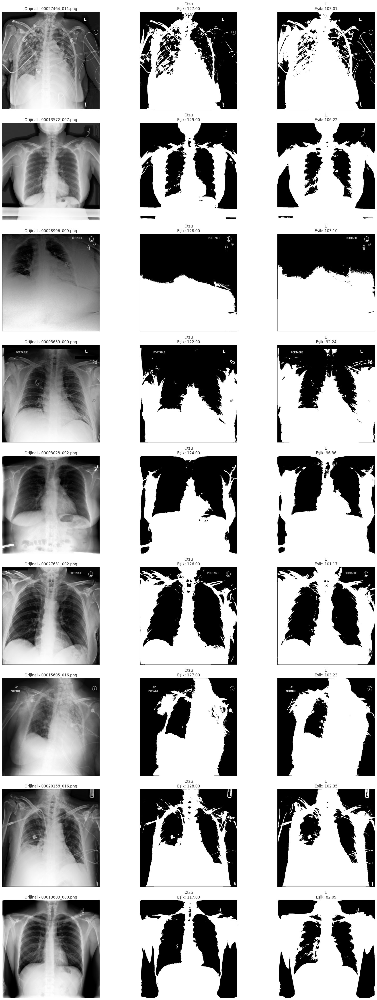

In [36]:
from skimage import filters
import matplotlib.pyplot as plt

# 9 satır, 3 sütun için subplot oluştur
fig, axes = plt.subplots(9, 3, figsize=(20, 45))  # 9 satır, 3 sütun
results_5 = []

for i, (img_name, gaussian_blurred, thresholded_image) in enumerate(results_4):  # Her bir görüntü için işlem yap
    # 1. Otsu Thresholding
    otsu_thresh = filters.threshold_otsu(gaussian_blurred)
    binary_otsu = gaussian_blurred > otsu_thresh

    # 2. Li Thresholding
    li_thresh = filters.threshold_li(gaussian_blurred)
    binary_li = gaussian_blurred > li_thresh

    # Konsola eşik değerlerini yazdır
    print(f"{img_name} için:")
    print(f"  - Otsu Eşiği: {otsu_thresh:.2f}")
    print(f"  - Li Eşiği: {li_thresh:.2f}")

    # Görselleştirme
    axes[i, 0].imshow(gaussian_blurred, cmap="gray")
    axes[i, 0].set_title(f"Orijinal - {img_name}")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(binary_otsu, cmap="gray")
    axes[i, 1].set_title(f"Otsu\nEşik: {otsu_thresh:.2f}")
    axes[i, 1].axis("off")

    axes[i, 2].imshow(binary_li, cmap="gray")
    axes[i, 2].set_title(f"Li\nEşik: {li_thresh:.2f}")
    axes[i, 2].axis("off")

    # Yorum: Daha uygun threshold yöntemini seçme
    if otsu_thresh < li_thresh:
        print(f"  - Otsu Thresholding, Li'ye göre daha düşük bir eşik değeri sağladı.")
    else:
        print(f"  - Li Thresholding, Otsu'ya göre daha düşük bir eşik değeri sağladı.")

    # Sonuçları kaydet
    results_5.append([img_name,gaussian_blurred ,thresholded_image, binary_otsu, binary_li])

# Görselleri hizala ve göster
plt.tight_layout()
plt.show()


# Otsu Yöntemi (Orta Sütun):

- Eşik değeri genelde daha yüksek olduğundan, beyaz alanlar (nesneler) daha sınırlıdır.
- Daha muhafazakar bir segmentasyon sağlar; yalnızca çok net olarak nesne piksellerini seçer.
- Örneğin, ilk görüntüde Otsu yöntemi sadece en belirgin alanları nesne olarak sınıflandırmıştır.

# Li Yöntemi (Sağ Sütun):

- Daha düşük eşik değerleri nedeniyle beyaz alanlar daha fazladır.
- Detaylara daha hassastır, ancak bu durum gürültüye (fazla segmentasyona) neden olabilir.
- Örneğin, ikinci görüntüde Li yöntemi ile segmentasyon yapıldığında, daha fazla piksel nesne olarak sınıflandırılmıştır.

# Orijinal Görseller (Sol Sütun):

- Görsellerin kontrastı ve parlaklık dağılımı, hangi yöntemin daha uygun olduğuna karar vermede önemlidir.
- Örneğin, düşük kontrastlı bölgelerde Li yöntemi daha iyi sonuç verirken, net sınırların olduğu yüksek kontrastlı bölgelerde Otsu yöntemi daha avantajlıdır.

# Post-processing

00027464_011.png - Bölge Sayısı: 21
Bölge 1:
  Alan (Area): 590848.0
  Çevre (Perimeter): 18463.870298737776
  Eksantriklik (Eccentricity): 0.6514933067217492
  Yoğunluk Ortalaması (Mean Intensity): 135.30339613572357
  Merkezi (Centroid): (598.5874082674393, 420.5054176370234)
Bölge 2:
  Alan (Area): 401.0
  Çevre (Perimeter): 105.31370849898477
  Eksantriklik (Eccentricity): 0.8783484348432322
  Yoğunluk Ortalaması (Mean Intensity): 228.785536159601
  Merkezi (Centroid): (84.28927680798004, 869.5261845386534)
Bölge 3:
  Alan (Area): 139.0
  Çevre (Perimeter): 48.698484809835
  Eksantriklik (Eccentricity): 0.585679333162671
  Yoğunluk Ortalaması (Mean Intensity): 95.84892086330935
  Merkezi (Centroid): (88.62589928057554, 650.2517985611511)
Bölge 4:
  Alan (Area): 388.0
  Çevre (Perimeter): 134.8111831820431
  Eksantriklik (Eccentricity): 0.9529813894507845
  Yoğunluk Ortalaması (Mean Intensity): 106.76030927835052
  Merkezi (Centroid): (140.1520618556701, 71.64948453608247)
Bölge 5:


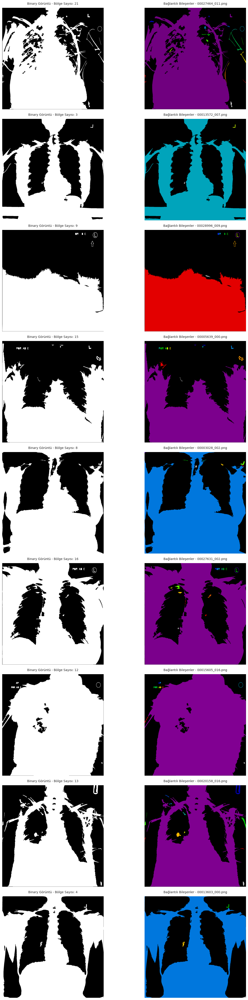

In [37]:
from skimage.filters import threshold_otsu
from skimage import morphology, measure

# 9 satır, 2 sütun için subplot oluştur
fig, axes = plt.subplots(9, 2, figsize=(15, 45))  # 9 satır, 2 sütun
results_6 = []
for i, (img_name, _, _) in enumerate(results):  # Sonuç listesindeki her bir görüntü için işlem yap
    # Görüntüyü yükle ve gri tonlamaya çevir
    img_path = os.path.join(img_dir, img_name)
    cropped_image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

    # 1. Thresholding (Otsu ile binary görüntü elde et)
    thresh_val = threshold_otsu(cropped_image)
    binary_image = cropped_image > thresh_val

    # 2. Morfolojik işlemler (küçük objeleri kaldırma ve delikleri doldurma)
    binary_image = morphology.remove_small_objects(binary_image, min_size=100)  # Küçük objeleri kaldır
    binary_image = morphology.remove_small_holes(binary_image, area_threshold=200)  # Delikleri doldur

    # 3. Bağlantılı bileşen analizi
    labels = measure.label(binary_image)  # Bölgeleri etiketle
    props = measure.regionprops(labels, intensity_image=cropped_image)  # Özellikleri hesapla

    # Bölge sayısını yazdır
    print(f"{img_name} - Bölge Sayısı: {len(props)}")

    # Özellikleri yazdır (en az 5 özellik)
    for j, prop in enumerate(props):
        print(f"Bölge {j + 1}:")
        print(f"  Alan (Area): {prop.area}")
        print(f"  Çevre (Perimeter): {prop.perimeter}")
        print(f"  Eksantriklik (Eccentricity): {prop.eccentricity}")
        print(f"  Yoğunluk Ortalaması (Mean Intensity): {prop.mean_intensity}")
        print(f"  Merkezi (Centroid): {prop.centroid}")

    # Görselleştirme
    axes[i, 0].imshow(binary_image, cmap='gray')
    axes[i, 0].set_title(f"Binary Görüntü - Bölge Sayısı: {len(props)}", fontsize=10, pad=10)  # Üstüne yazı

    axes[i, 1].imshow(labels, cmap='nipy_spectral')
    axes[i, 1].set_title(f"Bağlantılı Bileşenler - {img_name}", fontsize=10, pad=10)  # Üstüne yazı

    axes[i, 0].axis("off")
    axes[i, 1].axis("off")
    results_6.append([img_name, binary_image])
# Görselleri hizala ve göster
plt.tight_layout()
plt.show()

Her görsel için bölgeler, ana anatomik yapıları (örneğin, akciğerler) ve olası artefaktları veya cihaz izlerini temsil etmektedir. Eksantriklik ve yoğunluk ortalaması değerleri, bu bölgelerin ne tür yapılar olduğunu anlamak için kullanılabilir. Görüntülerin tümü incelendiğinde, maske ve bağlantılı bileşen analizi ile oldukça ayrıntılı özellikler elde edilmiştir. Bu, detaylı bir görüntü analizi için sağlam bir temel sunar.

# 1. Görsel: 00027464_011.png
### Bölge Sayısı: 21
Görüntüde 21 bölge tespit edilmiştir. En büyük bölge (590,848 piksel) akciğerlerin büyük kısmını kapsıyor. Bu bölge düzgün bir yapıya sahip olup yoğunluk ortalaması (135.30) akciğer dokusu için uygun bir seviyede. Küçük bölgeler, cihaz izleri veya artefakt olarak değerlendirilebilir. Özellikle Bölge 2 (401 piksel) yüksek yoğunluklu (228.78) bir cihaz izi olabilir.
# 2. Görsel: 00013572_007.png
### Bölge Sayısı: 3
Görüntüde daha az sayıda bölge bulunmaktadır. En büyük bölge (479,727 piksel) düzgün bir yapı sergileyerek ana akciğer dokusunu temsil etmektedir. Yoğunluk ortalaması (163.47) bu alanın yumuşak doku olduğunu gösteriyor. Küçük bölgeler (292 ve 135 piksel), cihaz etkisi veya artefakt kaynaklı olabilir.
# 3. Görsel: 00028996_009.png
### Bölge Sayısı: 9
Görüntüdeki en büyük bölge (556,950 piksel) akciğer alanını temsil ediyor. Yoğunluk ortalaması (195.59) akciğer yapısıyla uyumlu. Küçük alanlardan Bölge 1 (416 piksel), yüksek yoğunluk (229.01) değerine sahip olup cihaz izi olarak değerlendirilebilir. Görüntüdeki diğer küçük alanlar gürültü veya iz bırakmış yapı olabilir.
# 4. Görsel: 00005639_000.png
### Bölge Sayısı: 15
Görüntüde 15 bölge tespit edilmiştir. En büyük bölge (550,846 piksel), düzgün bir şekilde ana akciğer dokusunu temsil ediyor. Eksantriklik değeri (0.761) bu alanın uzamış bir yapı sergilediğini ifade ediyor. Bölge 4 (375 piksel), cihaz izine işaret eden yüksek yoğunluk (221.56) değerine sahiptir.
# 5. Görsel: 00003028_002.png
### Bölge Sayısı: 8
En büyük bölge (626,460 piksel) düzgün bir şekilde akciğer alanını temsil ediyor. Eksantriklik değeri (0.477) bu alanın geniş bir yapıya sahip olduğunu gösteriyor. Bölge 3 (153 piksel), eksantriklik değeri (0.992) ile oldukça ince ve uzun bir yapıya sahiptir, bu da cihaz izi olabileceğini düşündürmektedir.
# 6. Görsel: 00027631_002.png
### Bölge Sayısı: 16
Görüntüde çok sayıda bölge tespit edilmiştir. En büyük bölge (702,801 piksel) düzgün bir yapıya sahip olup ana akciğer dokusunu temsil ediyor. Bölge 2 (396 piksel), cihaz izi olarak değerlendirilebilecek yüksek yoğunluk (227.15) değeriyle öne çıkıyor. Diğer küçük alanlar artefaktlar veya cihaz etkisi olabilir.
# 7. Görsel: 00015605_016.png
### Bölge Sayısı: 12
En büyük bölge (807,274 piksel), geniş bir akciğer alanını temsil ediyor. Eksantriklik değeri (0.461) bu alanın düzgün bir yapıya sahip olduğunu gösteriyor. Bölge 2 (142 piksel), yüksek yoğunluk değerine (212.82) sahip olup cihaz izi olabilir.
# 8. Görsel: 00020158_016.png
### Bölge Sayısı: 13
En büyük bölge (548,645 piksel), düzgün bir şekilde akciğer alanını temsil ediyor. Yoğunluk ortalaması (177.47) bu alanın yumuşak doku olduğunu gösteriyor. Küçük bölgelerden Bölge 2 (2,510 piksel), cihaz izi olabilecek yüksek yoğunlukta (147.25) bir yapı göstermektedir.
# 9. Görsel: 00013603_000.png
### Bölge Sayısı: 4
Görüntüdeki en büyük bölge (532,283 piksel), düzgün bir şekilde akciğer dokusunu temsil ediyor. Eksantriklik değeri (0.312) bu bölgenin yuvarlak bir yapıya sahip olduğunu ifade ediyor. Bölge 2 (398 piksel), cihaz etkisini temsil edebilecek yüksek yoğunluk (207.68) değerine sahiptir.

# Sonuçlar

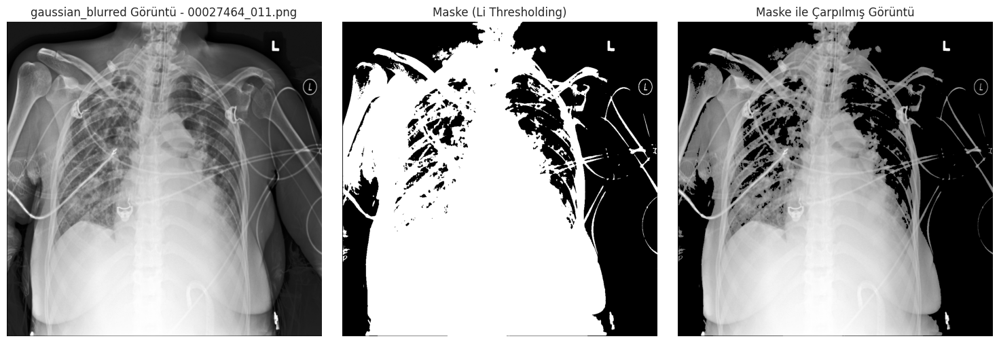

00027464_011.png için maske uygulandı ve görselleştirildi.


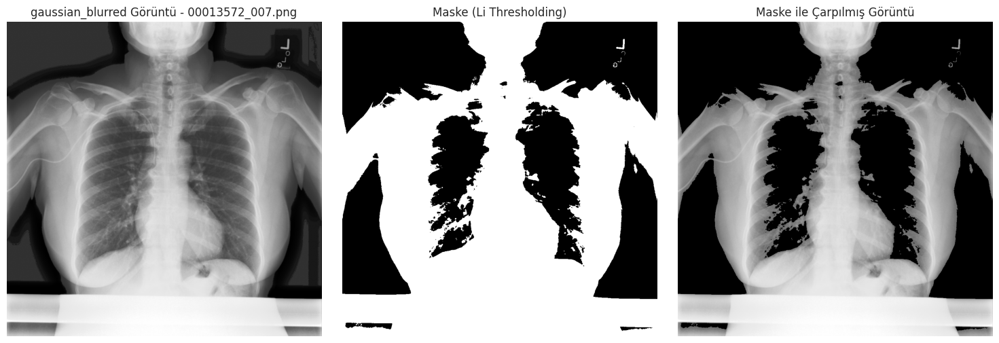

00013572_007.png için maske uygulandı ve görselleştirildi.


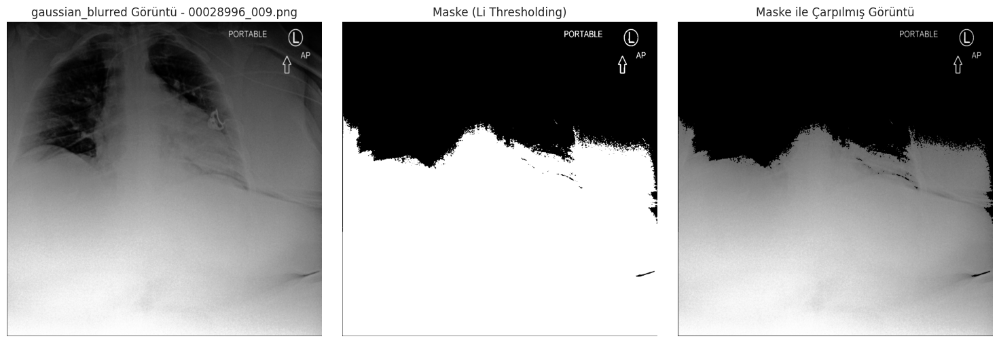

00028996_009.png için maske uygulandı ve görselleştirildi.


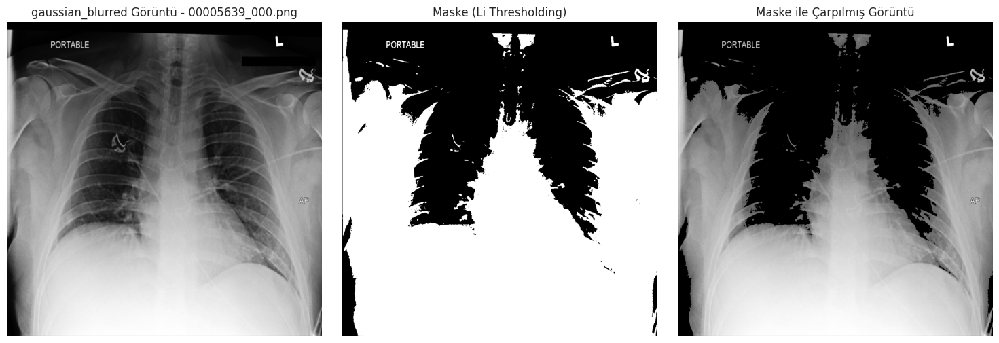

00005639_000.png için maske uygulandı ve görselleştirildi.


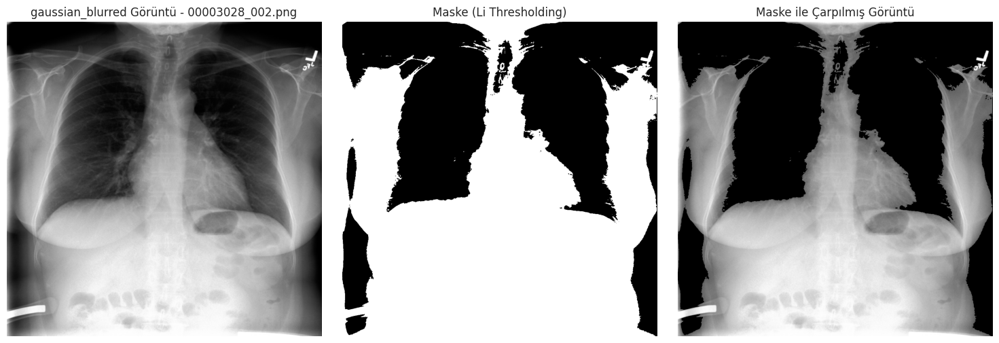

00003028_002.png için maske uygulandı ve görselleştirildi.


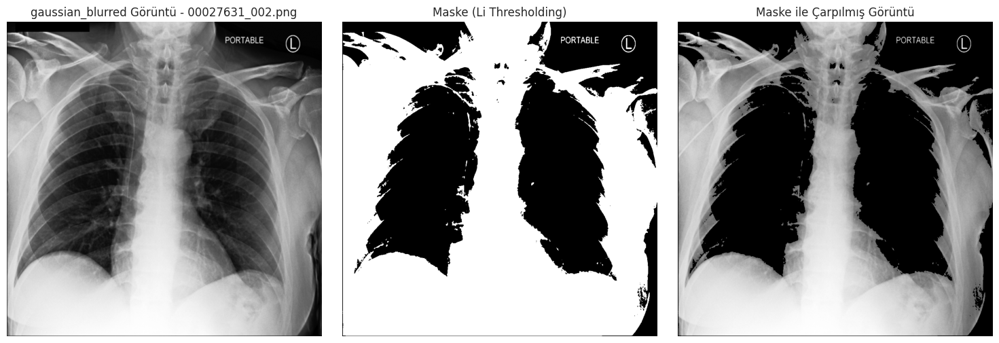

00027631_002.png için maske uygulandı ve görselleştirildi.


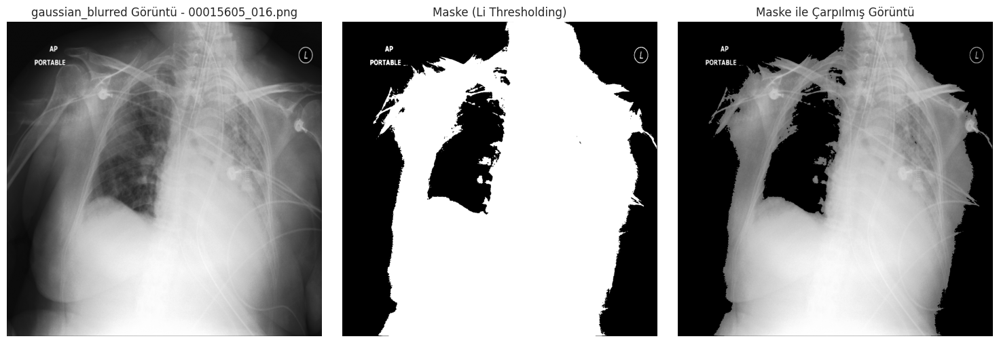

00015605_016.png için maske uygulandı ve görselleştirildi.


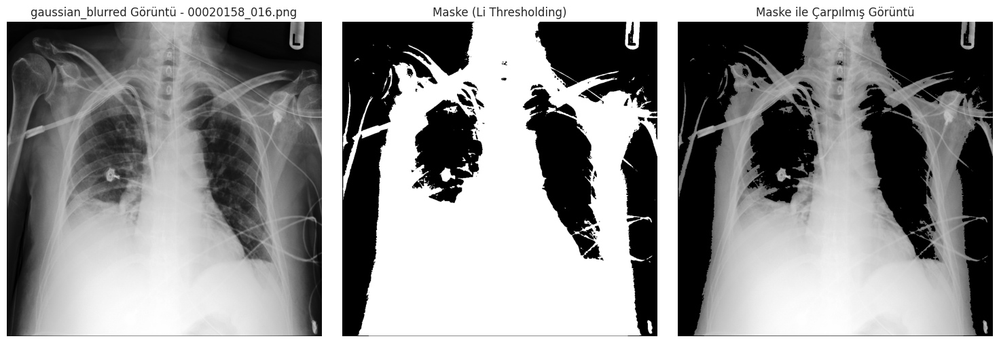

00020158_016.png için maske uygulandı ve görselleştirildi.


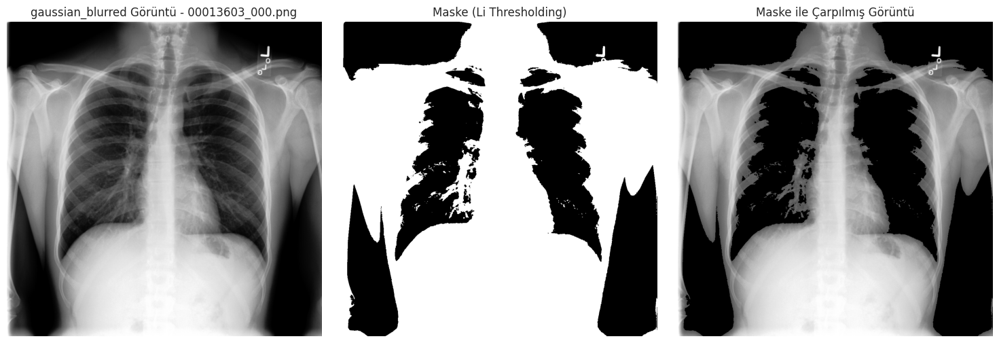

00013603_000.png için maske uygulandı ve görselleştirildi.


In [38]:
import numpy as np
import matplotlib.pyplot as plt

# Daha önceki sonuçlardan elde edilen Otsu veya Li maskesini kullan
for img_name,gaussian_blurred ,thresholded_image, binary_otsu, binary_li in results_5:
    # Maske olarak Li veya Otsu seçimi
    mask = binary_li  # Li thresholding kullanılıyor (uygunsa binary_otsu da seçilebilir)

    # Maskeyi orijinal görüntüyle çarp
    masked_image = gaussian_blurred * mask

    # Görselleştirme
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Orijinal görüntü
    axes[0].imshow(gaussian_blurred, cmap='gray')
    axes[0].set_title(f'gaussian_blurred Görüntü - {img_name}')
    axes[0].axis('off')

    # Maske
    axes[1].imshow(mask, cmap='gray')
    axes[1].set_title('Maske (Li Thresholding)')
    axes[1].axis('off')

    # Maskeyle çarpılmış görüntü
    axes[2].imshow(masked_image, cmap='gray')
    axes[2].set_title('Maske ile Çarpılmış Görüntü')
    axes[2].axis('off')

    # Tüm görselleri göster
    plt.tight_layout()
    plt.show()

    # Yorumlama
    print(f"{img_name} için maske uygulandı ve görselleştirildi.")


# Maske ile Çarpılmış Görüntü:

- Gaussian blurred görüntü ile maske çarpılarak sadece maskenin beyaz bölgelerinde kalan piksellerin görünür olması sağlanmıştır.
- Siyah alanlar (0) tamamen baskılanmış, bu da dikkat edilmesi gereken bölgelerin daha net görünmesini sağlamıştır.

- Akciğer iç yapıları belirgin hale gelmiştir.

- Bu yöntemin, tıbbi görüntüleme gibi yüksek hassasiyet gerektiren alanlarda dikkat edilmesi gereken bölgeleri netleştirme açısından başarılı olduğu söylenebilir.



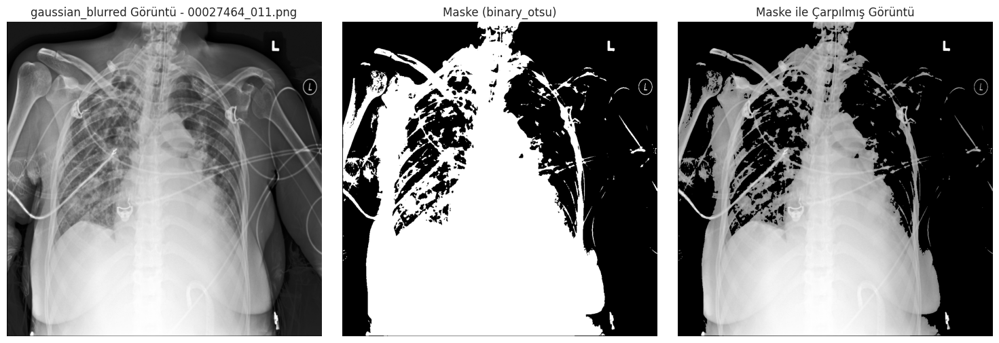

00027464_011.png için maske uygulandı ve görselleştirildi.


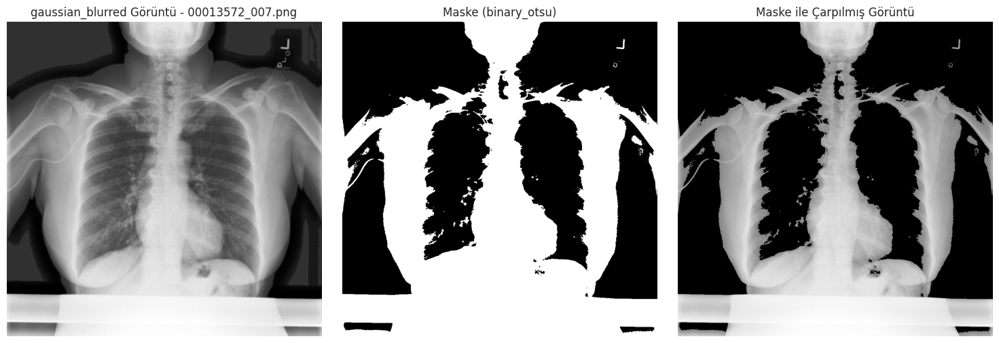

00013572_007.png için maske uygulandı ve görselleştirildi.


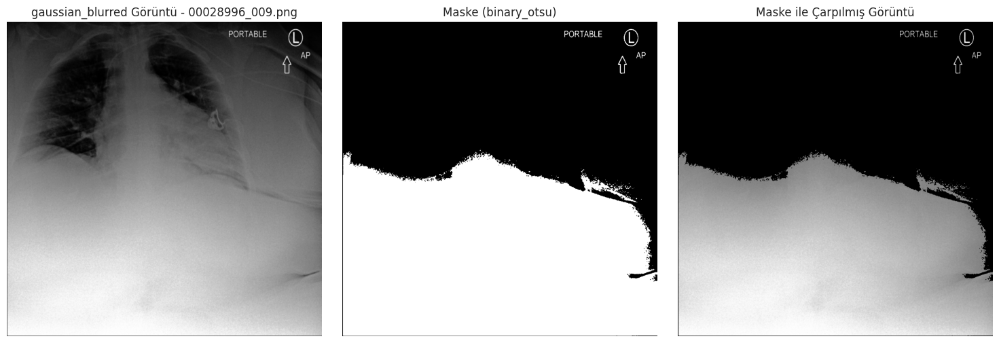

00028996_009.png için maske uygulandı ve görselleştirildi.


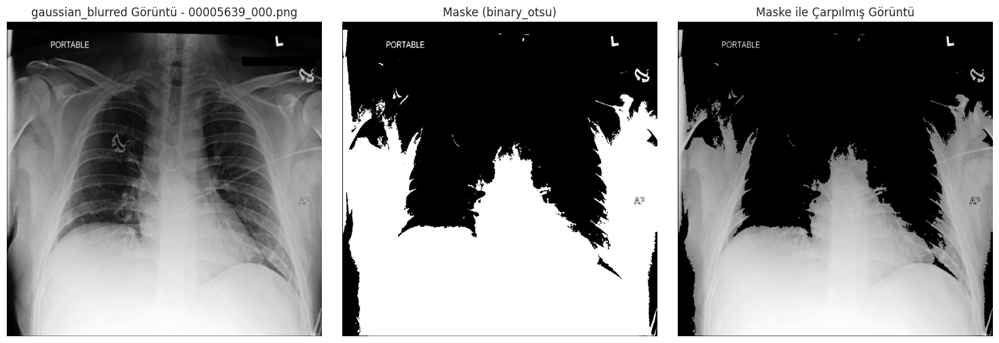

00005639_000.png için maske uygulandı ve görselleştirildi.


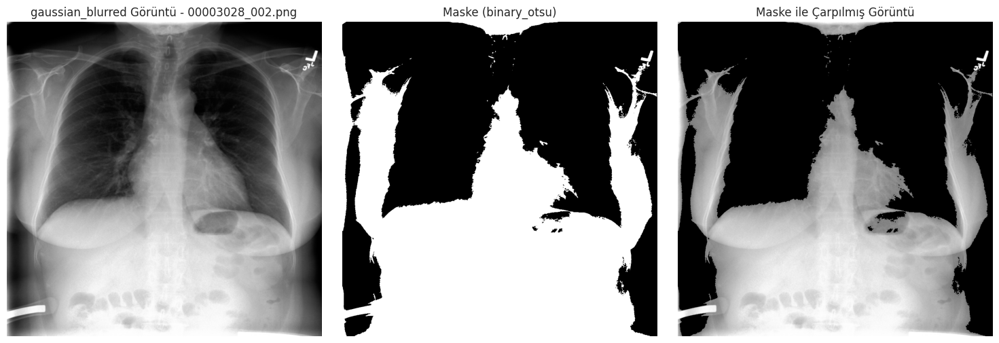

00003028_002.png için maske uygulandı ve görselleştirildi.


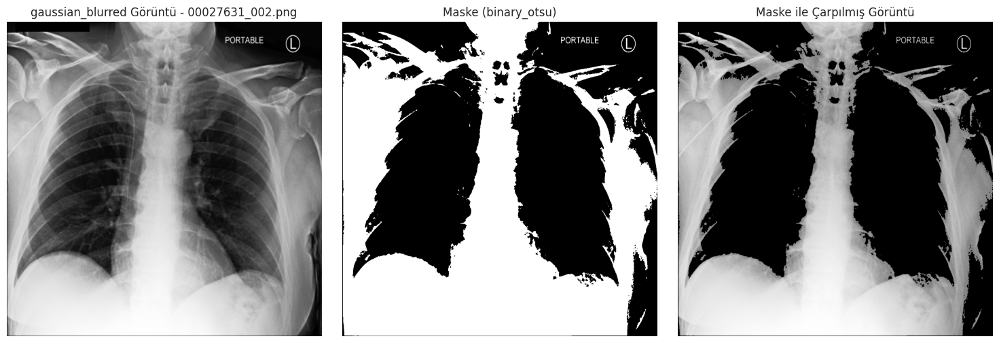

00027631_002.png için maske uygulandı ve görselleştirildi.


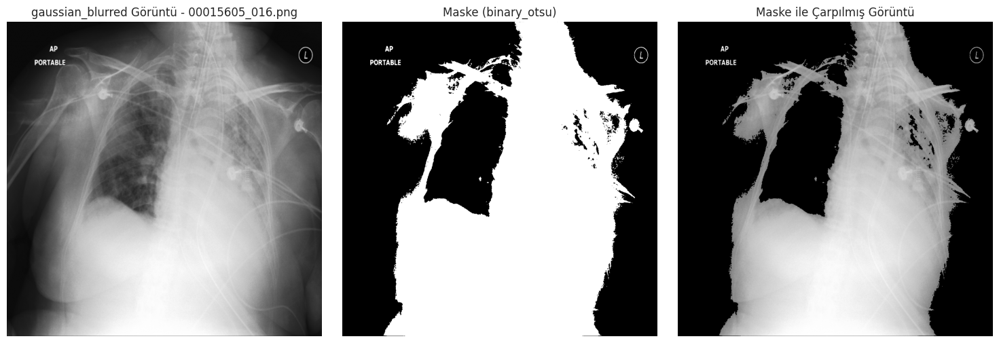

00015605_016.png için maske uygulandı ve görselleştirildi.


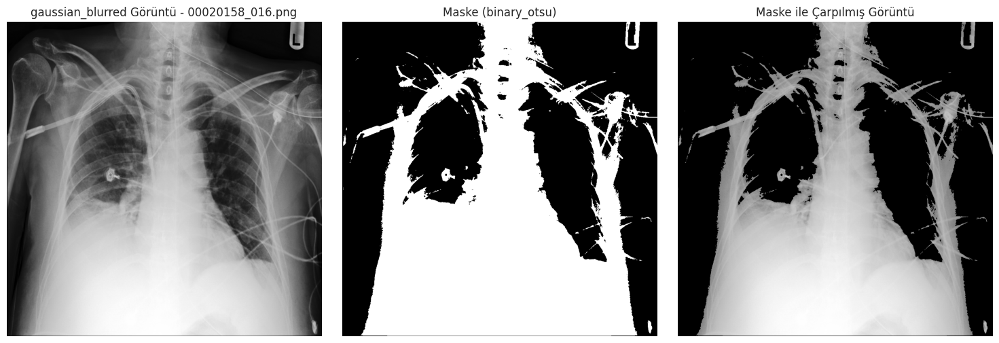

00020158_016.png için maske uygulandı ve görselleştirildi.


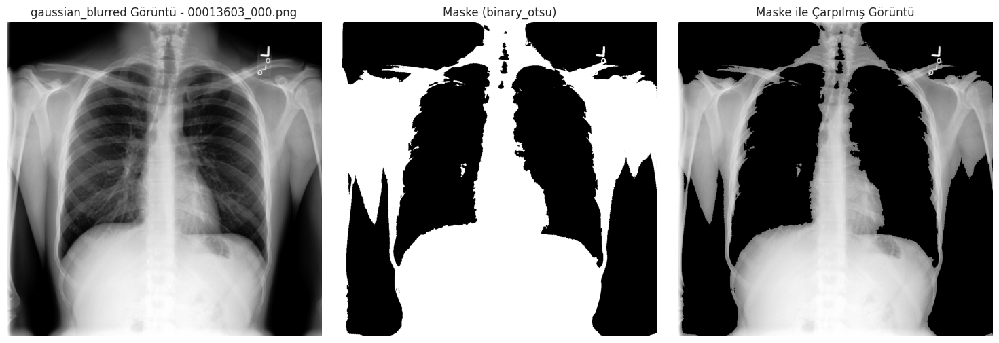

00013603_000.png için maske uygulandı ve görselleştirildi.


In [39]:
import numpy as np
import matplotlib.pyplot as plt

# Daha önceki sonuçlardan elde edilen Otsu veya Li maskesini kullan
for img_name,gaussian_blurred ,thresholded_image, binary_otsu, binary_li in results_5:
    # Maske olarak Li veya Otsu seçimi
    mask = binary_otsu  # Li thresholding kullanılıyor (uygunsa binary_otsu da seçilebilir)

    # Maskeyi orijinal görüntüyle çarp
    masked_image = gaussian_blurred * mask

    # Görselleştirme
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Orijinal görüntü
    axes[0].imshow(gaussian_blurred, cmap='gray')
    axes[0].set_title(f'gaussian_blurred Görüntü - {img_name}')
    axes[0].axis('off')

    # Maske
    axes[1].imshow(mask, cmap='gray')
    axes[1].set_title('Maske (binary_otsu)')
    axes[1].axis('off')

    # Maskeyle çarpılmış görüntü
    axes[2].imshow(masked_image, cmap='gray')
    axes[2].set_title('Maske ile Çarpılmış Görüntü')
    axes[2].axis('off')

    # Tüm görselleri göster
    plt.tight_layout()
    plt.show()

    # Yorumlama
    print(f"{img_name} için maske uygulandı ve görselleştirildi.")

# Maske ile Çarpılmış Görüntü:

- Maskeyle çarpılmış görüntülerde, maskenin beyaz olduğu alanlar korunmuş, siyah olan bölgeler ise tamamen karartılmıştır.
- Bu işlem, odaklanılması gereken alanları netleştirmek açısından faydalıdır.
- Ancak, bazı görüntülerde maskenin ilgili alanların bir kısmını dışarıda bırakması veya gereksiz alanları içermesi dikkat çekmektedir. Bu durum, kullanılan eşikleme yönteminin parametrelerinin daha iyi ayarlanmasını gerektirebilir.

# Maske Kalitesi:

Maske genel olarak başarılı görünmekle birlikte, bazı detaylar maskede kaybolmuş olabilir. Özellikle maskenin çok geniş veya çok dar seçildiği durumlarda, eşik değeri optimize edilebilir.
Alternatif olarak, Li Thresholding gibi başka yöntemlerle maskeler karşılaştırılabilir.
# Akciğer Alanlarının Netliği:

Maskenin beyaz bölgeleri, akciğer gibi ilgilenilen alanların büyük bir kısmını temsil etmektedir.
Ancak, bazı durumlarda maske, özellikle dış bölgelerde gereksiz alanları içerebilir.
Thresholding Yönteminin Performansı:

Otsu thresholding yöntemi, belirli bir histogram dağılımına dayalı olarak çalışır. Ancak farklı histogram dağılımlarında performansını iyileştirmek için adaptif thresholding veya daha dinamik yöntemler kullanılabilir.

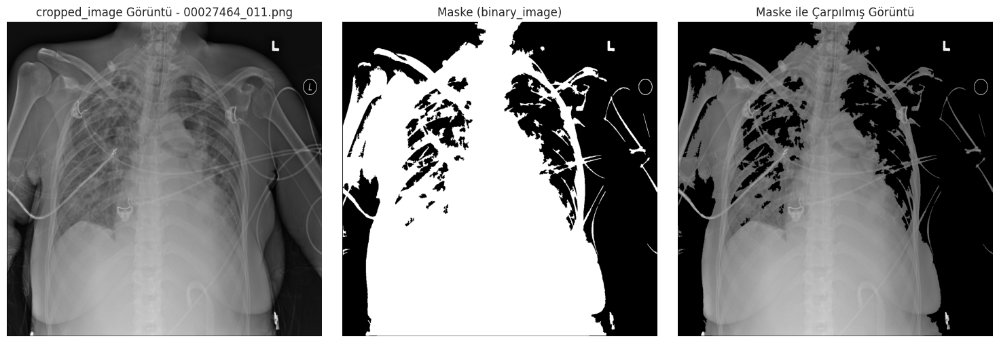

00027464_011.png için maske uygulandı ve görselleştirildi.


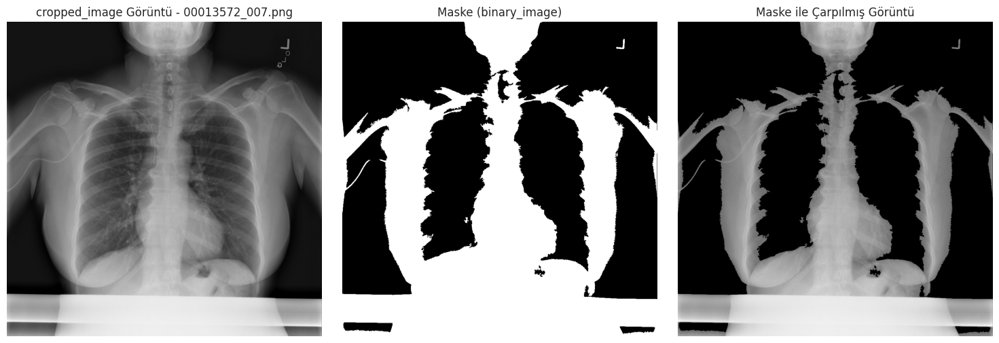

00013572_007.png için maske uygulandı ve görselleştirildi.


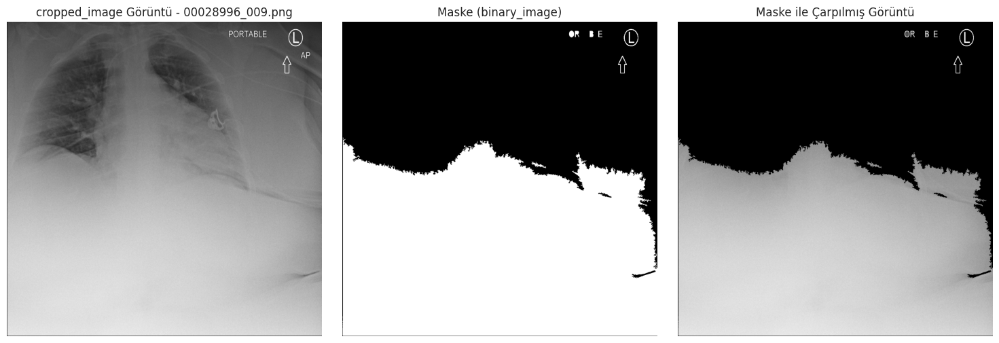

00028996_009.png için maske uygulandı ve görselleştirildi.


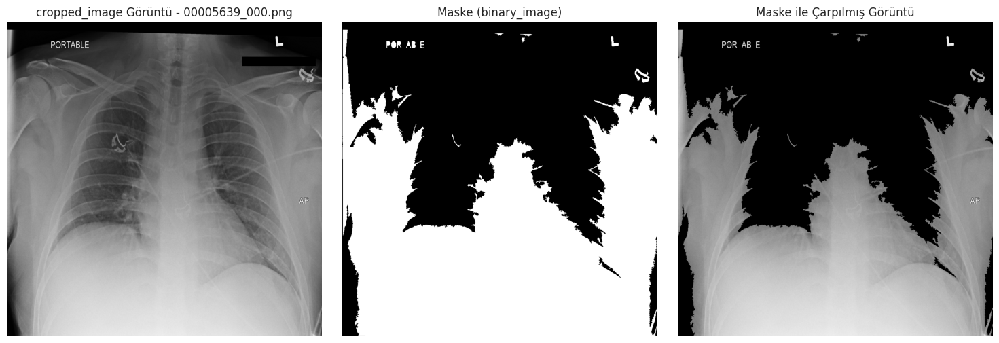

00005639_000.png için maske uygulandı ve görselleştirildi.


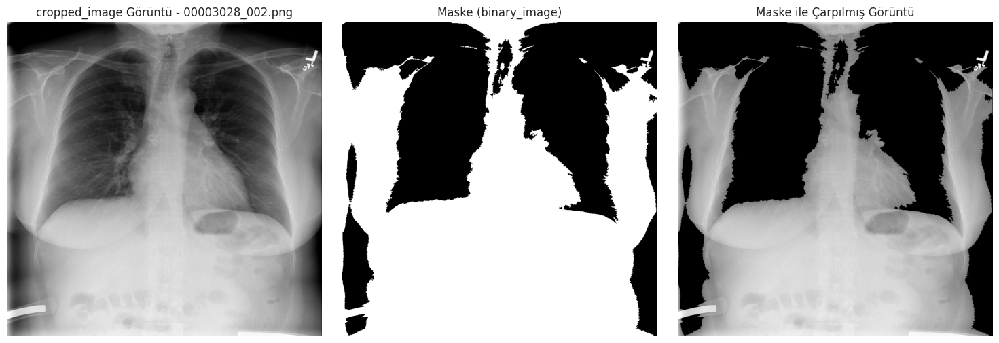

00003028_002.png için maske uygulandı ve görselleştirildi.


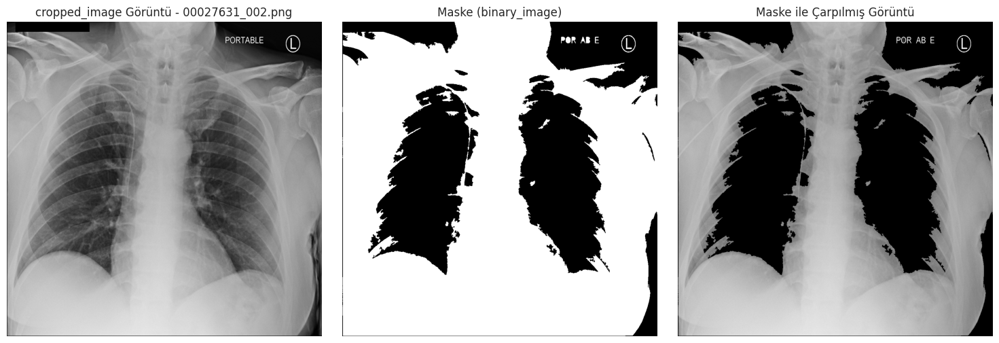

00027631_002.png için maske uygulandı ve görselleştirildi.


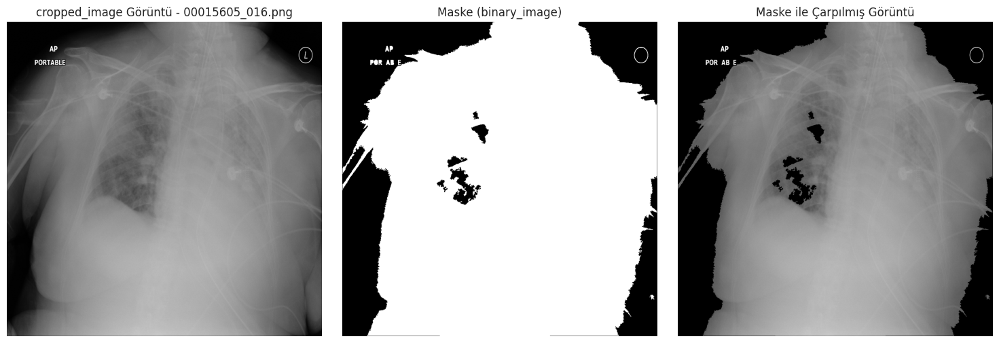

00015605_016.png için maske uygulandı ve görselleştirildi.


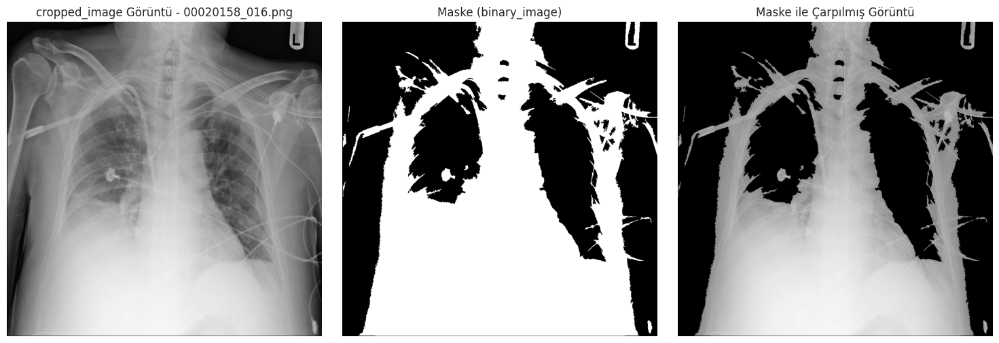

00020158_016.png için maske uygulandı ve görselleştirildi.


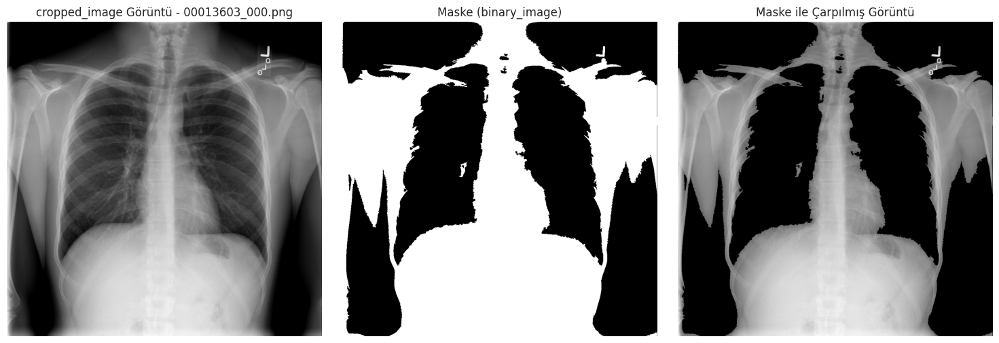

00013603_000.png için maske uygulandı ve görselleştirildi.


In [40]:
import numpy as np
import matplotlib.pyplot as plt

# Daha önceki sonuçlardan elde edilen Otsu veya Li maskesini kullan
for  i, (img_name, binary_image) in enumerate(results_6):
    img_path = os.path.join(img_dir, img_name)
    cropped_image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    # Maske olarak Li veya Otsu seçimi
    mask = binary_image  # Li thresholding kullanılıyor (uygunsa binary_otsu da seçilebilir)

    # Maskeyi orijinal görüntüyle çarp
    masked_image = cropped_image * mask

    # Görselleştirme
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Orijinal görüntü
    axes[0].imshow(cropped_image, cmap='gray')
    axes[0].set_title(f'cropped_image Görüntü - {img_name}')
    axes[0].axis('off')

    # Maske
    axes[1].imshow(mask, cmap='gray')
    axes[1].set_title('Maske (binary_image)')
    axes[1].axis('off')

    # Maskeyle çarpılmış görüntü
    axes[2].imshow(masked_image, cmap='gray')
    axes[2].set_title('Maske ile Çarpılmış Görüntü')
    axes[2].axis('off')

    # Tüm görselleri göster
    plt.tight_layout()
    plt.show()

    # Yorumlama
    print(f"{img_name} için maske uygulandı ve görselleştirildi.")

# Maske ile Çarpılmış Görüntü (Sağ Panel):

- Orijinal görüntüler ile maskeler çarpılmış, yalnızca maskenin beyaz alanları görüntüde tutulmuş.
- Bu işlem, ilgilenilen bölgelerin daha net görünmesini sağlamış.
- Ancak bazı maskelerde küçük parçalar korunmuş, bu da ilgili bölgeyi temsil etmekte eksiklik oluşturabilir.

Bu işlem, özellikle ilgilenilen bölgeleri daha net izole etmek ve analiz etmek için başarılı bir adımdır. Ancak, maskelerin doğruluğunu artırmak ve fazla bilgiyi baskılamak için daha ileri düzey optimizasyonlar yapılabilir. Görsellerin amacına bağlı olarak, seçilen thresholding yöntemlerinin performansı analiz edilmelidir. Eğer görüntülerin belirli bir kısmında önemli bilgi kaybı varsa, bunun nedenini araştırarak çözüm önerileri uygulanabilir.